[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/mostafaelaraby/gan-random-projection-pytorch/blob/master/gans_with_random_projections.ipynb)

In [0]:
import os
import requests
import random
import shutil
from tqdm import tqdm_notebook as tqdm
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.distributions import normal

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from IPython.display import HTML


# Model Parameters

In [0]:
# Set random seem for reproducibility
manualSeed = 7 #@param {type: "integer"}
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
np.random.seed(manualSeed)

Random Seed:  7


In [0]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")
# root folder for train data extraction
data_root = 'data'
# Number of workers for dataloader
workers = 2
batch_size = 128  #@param
img_size= 64 # to change image size discriminator and generator architecture needs to be updated

noise_latent_dim = 100  #@param {type: "integer"}
n_feature_maps_d = 64   #@param {type: "integer"}
n_feature_maps_g = 64   #@param {type: "integer"}

n_epochs = 10  #@param {type: "integer"}
# Optimizer parameters
lr = 2e-4

beta1 = 0.5  # needs smaller decay on the mean moments in Adam for slower convergence of the discriminator to avoid the discriminator fast training and the generator unable to learn




# Utilities for the training

In [0]:
# data usl used for the dataset url to download from needs to be .tar.gz
# path of the images inside this archive 
# data_root is the train data root that will include the data output /data_root/train/*.jpg 
def dataset_download_prepare(data_url,data_path_in_archive,data_root = ''):
  if not(os.path.isdir(data_root)) and data_root.strip() != '':
    os.mkdir(data_root)
  download_f_name = 'dataset-sprites.tar.gz'
  if not(os.path.isfile(download_f_name)):
    
    os.system('wget  -O {} {}'.format(download_f_name,data_url))

  if not(os.path.isdir(os.path.join(data_root,'train')) and len(os.listdir(os.path.join(data_root,'train'))))>0:
    # extract archive file content
    if not(os.path.isdir('dataset-sprites')):
      os.mkdir('dataset-sprites')
    os.system('tar xf {} -C {}  --strip-components 1'.format(download_f_name,'dataset-sprites'))
    if not(os.path.isdir(os.path.join(data_root,'train'))):
      os.makedirs(os.path.join(data_root,'train'))
    img_files  = os.listdir(os.path.join('dataset-sprites',data_path_in_archive))
    for image_name in tqdm(img_files):
      shutil.move(os.path.join('dataset-sprites',data_path_in_archive,image_name),os.path.join(data_root,'train'))
    shutil.rmtree('dataset-sprites')
    
    
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        

def visualize_disc_generator_loss(g_losses, d_losses):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(g_losses,label="G")
    plt.plot(d_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

def show_real_fake_images(train_loader,img_list):
    # Grab a batch of real images from the dataloader
    real_batch = next(iter(train_loader))

    # Plot the real images
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.axis("off")
    plt.title("Real Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

    # Plot the fake images from the last epoch
    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list,(1,2,0)))
    plt.show()
    
def show_images(img_list,legend = "Fake Images"):
    plt.figure(figsize=(16,16))
    plt.axis("off")
    plt.title(legend)
    plt.imshow(np.transpose(img_list,(1,2,0)))
    plt.show()
  
def clones(module, N):
  "A helper function for producing N identical layers (each with their own parameters)."
  return nn.ModuleList([copy.deepcopy(module) for _ in range(N)])

def latent_embeding_show(generator_model, noise_space_1,noise_space_2, nb_frames):
    """Used to check the latent space of the trained model"""
    imgs = []
    for i in range(nb_frames):
        alpha = i / nb_frames
        z = (1 - alpha) * noise_space_1 + alpha * noise_space_2
        imgs.append(generator_model(z.to(device)).detach().cpu())
    imgs = torch.cat(imgs,0).detach().cpu()
    plt.figure(figsize=(15,15))
    plt.axis("off")
    plt.title("Generated Images")
    plt.imshow(vutils.make_grid(imgs,nrow=nb_frames, padding=2, normalize=True).permute(1, 2, 0))
    plt.show()

## Generating Random Projections

In [0]:
def generate_random_filters(n_filters = 12, ksize = 8, stride = 2 ):
    wts = {}
    for nfilt in range(n_filters):
        pfi = np.random.normal(size=(1,3,ksize,ksize))
        pfi = np.float32(pfi)
        pfi = pfi / np.sqrt(np.sum(pfi*pfi,axis=(1,2,3)))
        wts['p%d' % nfilt] = pfi
        wts['s%d' % nfilt] = stride
    return wts

# model for illustration purposes of the output of random projection
class FilterCompute(nn.Module):
    def __init__(self,kernel_size, stride):
        super(FilterCompute, self).__init__()
        self.conv = nn.Conv2d(3, 1, kernel_size=kernel_size, stride=stride,bias=False)
        self.padding = (kernel_size - stride) //2
        self.constant_pad = nn.ConstantPad2d(self.padding,0)
        #for param in self.parameters():
        #  param.requires_grad = False
        

    def set_weights(self, w):
        self.conv.weight.data = torch.from_numpy(w).to(device)
        self.conv.weight.requires_grad = False


    def forward(self,x):
        if self.padding!=0:
          x = self.constant_pad(x)
        return self.conv(x)

## Model Training function
 method used for both single discriminator and multiple discriminator setup.

In [0]:
# loss can be kl Kullback–Leibler divergence as in the originial gan paper by Goodfellow
# or can be w for wgan
# filters used to create multiple discriminators each on a separate filter from paper
# stabilizing gan flr multiple random projections
def train_gan(n_epochs,discriminator_model,generator_model,train_data_loader,fixed_noise,loss = 'kl', filters = None):
    #todo add noise to train disc of 
    # 13 in gan hacks
    # batch set of noise created every iteration
    
    img_list = []
    G_losses = []
    D_losses = []
    iters = 0
    multiple_disc = False
    n_disc = 1

    optimizer_g = optim.Adam(generator_model.parameters(), lr=lr, betas=(beta1, 0.999)) # Setup Adam optimizers for both G and D
    
    if filters:
        n_disc = len(filters) //2
        discriminator_model = clones(discriminator_model, n_disc)
        optimizer_d = []
        for model_indx in range(n_disc):
            discriminator_model[model_indx].set_random_filter(filters['p'+str(model_indx)]) # setting random projection filters pre calculating and setting grad to false
            discriminator_model[model_indx].apply(weights_init)
            optimizer_d.append(optim.Adam(discriminator_model[model_indx].parameters(), lr=lr, betas=(beta1, 0.999)))
        multiple_disc = True
    else:
        optimizer_d = optim.Adam(discriminator_model.parameters(), lr=lr, betas=(beta1, 0.999))
    progress_bar =  tqdm(total=n_epochs)
    
    for epoch in range(n_epochs):
        # for each batch of real images
        for i, data in enumerate(train_data_loader, 0):
            if multiple_disc:
                discriminator_error_real = []
                discriminator_loss_fake = 0
                discriminator_average_real_pred = 0
                discriminator_average_fake_1 = 0
                discriminator_average_fake_2 = 0
                for model_indx in range(n_disc):
                    discriminator_model[model_indx].zero_grad()
            else:
                discriminator_model.zero_grad()

            real_images = data[0].to(device)
            local_batch_size =  real_images.size(0)
            # label smoothing as mentioned in https://arxiv.org/pdf/1606.03498.pdf
            labels = torch.full((local_batch_size,), real_label, device=device)\
                .uniform_(real_label - 0.2, real_label)

            # Forward pass real batch through D
            if multiple_disc:
                for model_indx in range(n_disc):
                    discriminator_output_real = discriminator_model[model_indx](real_images).view(-1)
                    disc_error = criterion(discriminator_output_real,labels)
                    discriminator_error_real.append(disc_error)
                    #compute the gradients
                    disc_error.backward()
                    discriminator_average_real_pred += discriminator_output_real.mean().item()
                discriminator_average_real_pred /= n_disc
            else:
                discriminator_output_real = discriminator_model(real_images).view(-1)
                # Calculate loss on all-real batch
                discriminator_error_real = criterion(discriminator_output_real, labels)
                #compute the gradients
                discriminator_error_real.backward()

                discriminator_average_real_pred = discriminator_output_real.mean().item()


            # now training with fake images coming from the generator

            noise = torch.randn(local_batch_size, noise_latent_dim, 1, 1, device=device)
            fake = generator_model(noise)
            labels.uniform_(fake_label, fake_label + 0.2)#.fill_(fake_label) 
            if multiple_disc:
                
                for model_indx in range(n_disc):
                    # fill it with fake labels and update the discriminator
                    discriminator_output_fake = discriminator_model[model_indx](fake.detach()).view(-1)
                    discriminator_error_fake = criterion(discriminator_output_fake, labels)
                    # update the discriminator with all fake batch
                    # compute gradients
                    discriminator_error_fake.backward()
                    discriminator_average_fake_1 += discriminator_output_fake.mean().item()

                    # Add the gradients from the all-real and all-fake batches
                    discriminator_error = discriminator_error_real[model_indx] + discriminator_error_fake
                    discriminator_loss_fake += discriminator_error.item()
                    # Update Discriminator model
                    optimizer_d[model_indx].step()
                discriminator_average_fake_1 /=n_disc
                D_losses.append(discriminator_loss_fake/n_disc)
                
            else:
                # fill it with fake labels and update the discriminator
                discriminator_output_fake = discriminator_model(fake.detach()).view(-1)
                # update the discriminator with all fake batch
                discriminator_error_fake = criterion(discriminator_output_fake, labels)

                # calculate all fake batch gradients
                discriminator_error_fake.backward()
                discriminator_average_fake_1 = discriminator_output_fake.mean().item()

                # Add the gradients from the all-real and all-fake batches
                discriminator_error = discriminator_error_real + discriminator_error_fake

                # Update Discriminator model
                optimizer_d.step()

                D_losses.append(discriminator_error.item())

            #############################
            # (2) Update G network: maximize log(D(G(z))) this is kl loss
            #############################

            generator_model.zero_grad()
            labels.fill_(real_label) # fake images are of real label with respect to the generator model

            # predicting the updated  discriminator on input fake images
            if multiple_disc:
                for model_indx in range(n_disc):
                    discriminator_output_fake = discriminator_model[model_indx](fake).view(-1)
                    if model_indx == 0:
                        generator_error_fake = criterion(discriminator_output_fake,labels)
                    else:
                        generator_error_fake += criterion(discriminator_output_fake,labels)
                    

                    discriminator_average_fake_2 += discriminator_output_fake.mean().item()
                    
                    
                generator_error_fake /= n_disc
                generator_error_fake.backward()
                #generator_error_fake.backward()
                discriminator_average_fake_2 /=n_disc
            else:
                discriminator_output_fake = discriminator_model(fake).view(-1)
                # we are just trying to fool the discriminator by optimizing against his output
                generator_error_fake = criterion(discriminator_output_fake,labels) 
                generator_error_fake.backward()
                discriminator_average_fake_2 = discriminator_output_fake.mean().item()

            optimizer_g.step()
            # Save Losses for plotting later
            G_losses.append(generator_error_fake.item())

            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 500 == 0) or ((epoch == n_epochs-1) and (i == len(dataloader)-1)):
                with torch.no_grad():
                    fake = generator_model(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        
            if i % 50 == 0:
                
                progress_bar.set_postfix({'Loss_D': str(D_losses[-1]),'Loss_G':str(G_losses[-1]), 'D(x)':str(discriminator_average_real_pred), 'D(G(z))':str(discriminator_average_fake_1) + ' / ' + str(discriminator_average_fake_2)})

            iters += 1
        progress_bar.update()

    return img_list, G_losses, D_losses


## Fixed Noise
Noise used to visualize the output of the generator during different steps of the training

In [0]:
#used to visualize changes of iimages through the different iterations
fixed_noise = torch.randn(batch_size, noise_latent_dim, 1, 1, device=device)

## DataSet download

In [0]:
!pip install gdown


In [0]:
import gdown
gdown.download('https://drive.google.com/uc?id=1DmP9MuJrY_XriSTyIeiOKTaQwsty8jIy&export=download','dataset-sprites.tar.gz',quiet=False)


Downloading...
From: https://drive.google.com/uc?id=1DmP9MuJrY_XriSTyIeiOKTaQwsty8jIy&export=download
To: /content/dataset-sprites.tar.gz
1.29GB [00:08, 161MB/s]


'dataset-sprites.tar.gz'

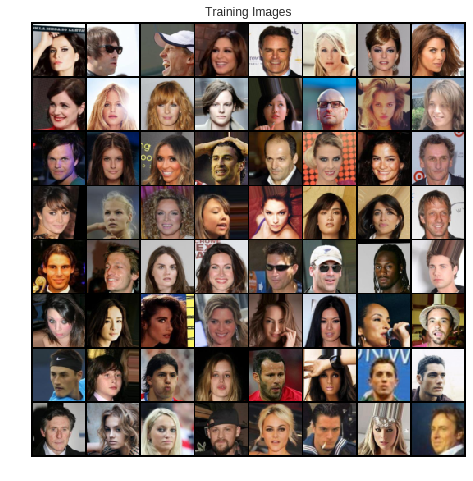

In [0]:
dataset_download_prepare('https://drive.google.com/open?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM','',data_root)#('https://s3.amazonaws.com/syaffers-stuff/datasets/pokemon-sprites.tar.gz','renamed',data_root)
dataset = dset.ImageFolder(root=data_root,
                           transform=transforms.Compose([
                               transforms.Resize(img_size),
                               transforms.CenterCrop(img_size),
                               transforms.ToTensor(), # move from pil range [0,255] to [0,1] range and to tensor format
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # used to move the range from [0,1] to [-1,1] which will match the tanh in the output which gives a good color variatiob
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# DCGAN Model

## Generator Model
![alt text](https://cdn-images-1.medium.com/max/800/1*B7y91tLgeWE-EuuFP-1XwA.png)

In [0]:
# Generator Code

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main =  nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( noise_latent_dim, n_feature_maps_g * 8, 4, 4, 0, bias=False),
            nn.BatchNorm2d(n_feature_maps_g * 8),
            nn.ReLU(True),
            # state size. (n_feature_maps_g*8) x 4 x 4
            nn.ConvTranspose2d(n_feature_maps_g * 8, n_feature_maps_g * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_g * 4),
            nn.ReLU(True),
            # state size. (n_feature_maps_g*4) x 8 x 8
            nn.ConvTranspose2d( n_feature_maps_g * 4, n_feature_maps_g * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_g * 2),
            nn.ReLU(True),
            # state size. (n_feature_maps_g*2) x 16 x 16
            nn.ConvTranspose2d( n_feature_maps_g * 2, n_feature_maps_g, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_g),
            nn.ReLU(True),
            # state size. (n_feature_maps_g) x 32 x 32
            nn.ConvTranspose2d( n_feature_maps_g, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        ) 

    def forward(self, input):
        return self.main(input)

In [0]:
dcganG = Generator().to(device)
dcganG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(4, 4), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

## Discriminator Model
![alt text](https://cdn-images-1.medium.com/max/800/1*QWEQqXmdTF285r1uS1t2eg.png)

In [0]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(3, n_feature_maps_d, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d) x 32 x 32
            nn.Conv2d(n_feature_maps_d, n_feature_maps_d * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*2) x 16 x 16
            nn.Conv2d(n_feature_maps_d * 2, n_feature_maps_d * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*4) x 8 x 8
            nn.Conv2d(n_feature_maps_d * 4, n_feature_maps_d * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*8) x 4 x 4
            nn.Conv2d(n_feature_maps_d * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [0]:
# Create the Discriminator
dcganD = Discriminator().to(device)
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
dcganD.apply(weights_init)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [0]:
# defining loss function
criterion = nn.BCELoss()
# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0


## Model Training

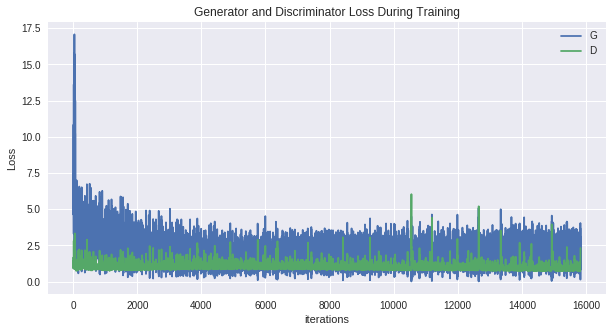

In [0]:
img_list, G_losses, D_losses = train_gan(n_epochs,dcganD,dcganG,dataloader,fixed_noise,loss = 'kl', filters = None)
visualize_disc_generator_loss(G_losses, D_losses)

## Visualizing output

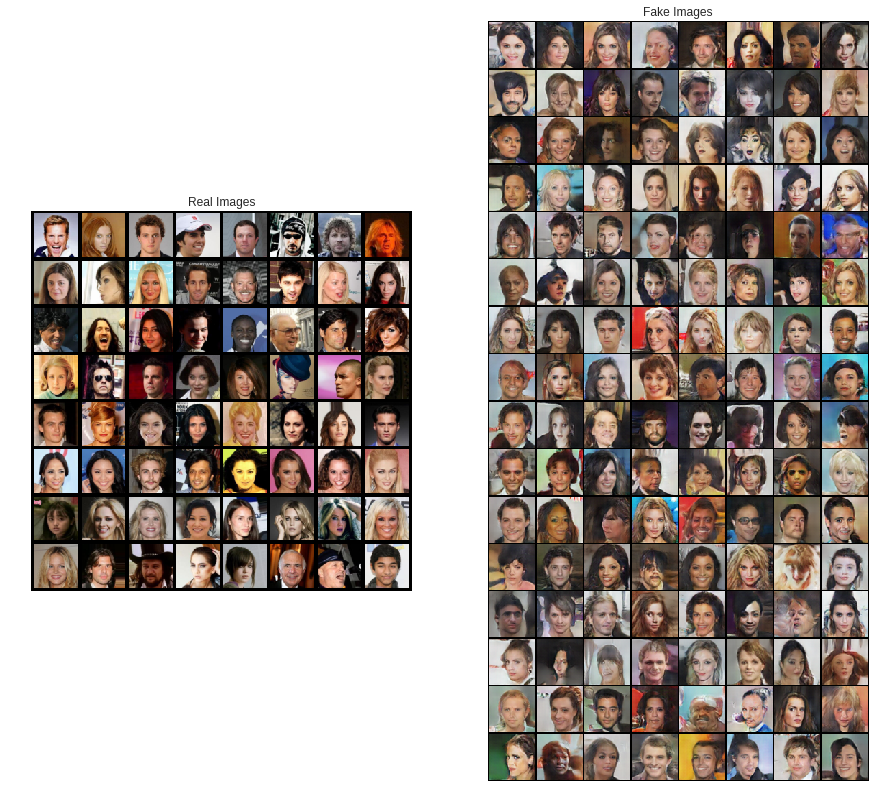

In [0]:
show_real_fake_images(dataloader,img_list[-1])


## Progression through training

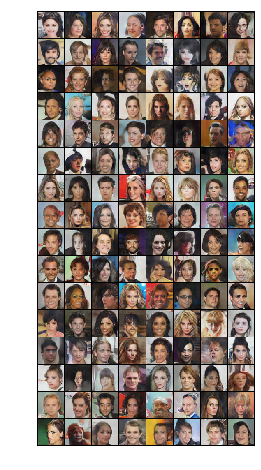

In [0]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Viewing Latent Space

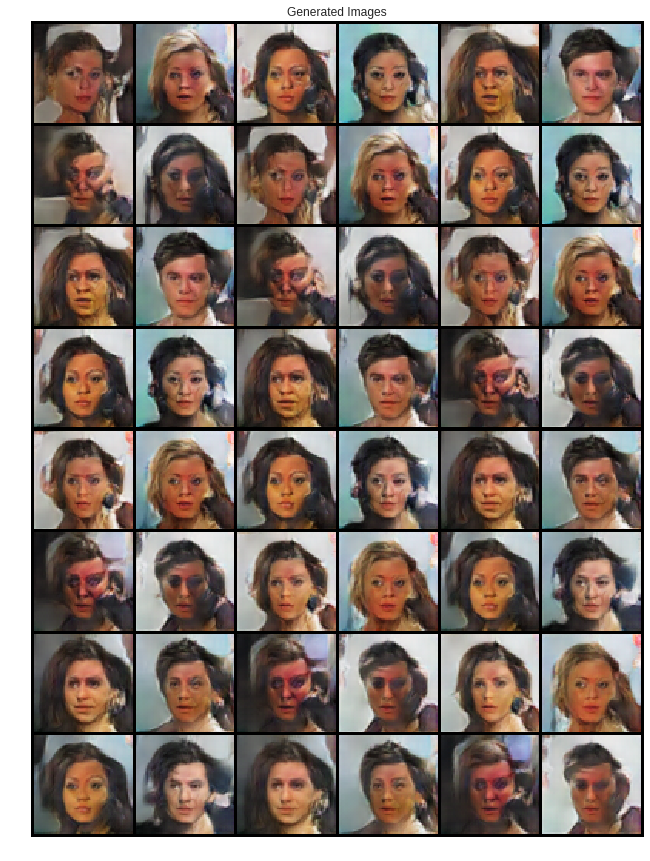

In [0]:
noise_1 = torch.rand((8,100,1,1))
noise_2 = torch.rand((8,100,1,1))
latent_embeding_show(dcganG, noise_1, noise_2, 6)

# Gan With Multiple Random Projection

This model is mroe stable than dcgan and needs more iterations to get better results the only drawback is the training time

## Discriminator model
same as the previous model except the first layer is replaced with a layer that computes the projection with fixed weights and without gradients

In [0]:

class DiscriminatorK(nn.Module):
    def __init__(self, kernel_size=8, stride=2):
        super(DiscriminatorK, self).__init__()
        self.padding = (kernel_size - stride) //2

        self.pad = nn.ConstantPad2d(self.padding,0) # as in the original code and publication of random projection
        self.random_projection_conv = nn.Conv2d(3, 1, kernel_size=kernel_size, stride=stride,bias=False)
        self.main = nn.Sequential(
            # state size. (n_feature_maps_d) x 32 x 32
            nn.Conv2d(1, n_feature_maps_d , 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*2) x 16 x 16
            nn.Conv2d(n_feature_maps_d , n_feature_maps_d * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*4) x 8 x 8
            nn.Conv2d(n_feature_maps_d * 2, n_feature_maps_d * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_feature_maps_d * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_feature_maps_d*8) x 4 x 4
            nn.Conv2d(n_feature_maps_d * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def set_random_filter(self, w):
        self.random_projection_conv.weight.data = torch.from_numpy(w).to(device)
        self.random_projection_conv.weight.requires_grad = False # it doesn't need grad

    def forward(self, input):
        input = self.pad(input)
        input = self.random_projection_conv(input)
        return self.main(input)

In [0]:
projectedG = Generator().to(device)
projectedG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(4, 4), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [0]:
filters = generate_random_filters(4) # filters for illustration with the kernel and stride we need for the projection
# Create the Discriminator
projectedD = DiscriminatorK(filters['p0'].shape[-1],filters['s0']).to(device)
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
projectedD.apply(weights_init)
x = torch.rand((128,3,64,64)).to(device)
projectedD(x).size()


torch.Size([128, 1, 1, 1])

## Visualizing Random Projections

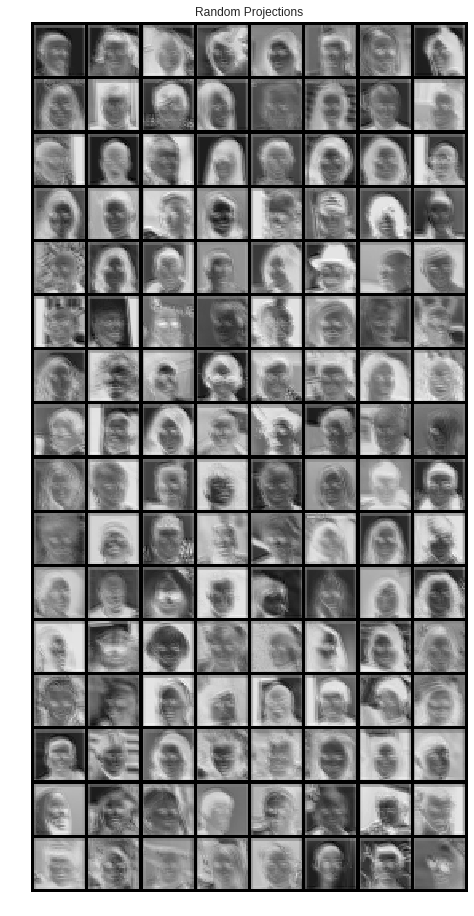

In [0]:


filter_apply_model = FilterCompute(filters['p0'].shape[-1],filters['s0']).to(device)
filter_apply_model.set_weights(filters['p2'])
images = next(iter(dataloader))[0].to(device)
images = filter_apply_model(images)
new_images = vutils.make_grid(images.detach().cpu(), padding=2, normalize=True)
show_images(new_images,'Random Projections')


## Model Training

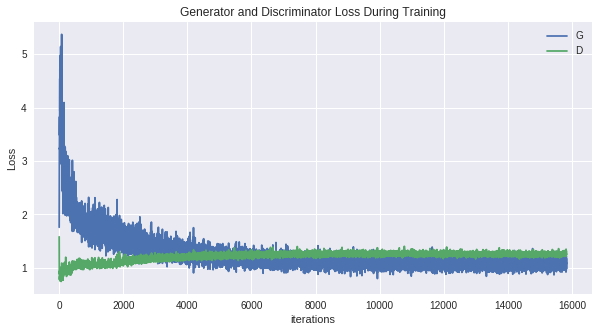

In [0]:
filters = generate_random_filters(12)
img_list_stable, G_losses_stable, D_losses_stable = train_gan(n_epochs,projectedD,projectedG,dataloader,fixed_noise,loss ='kl', filters=filters)
visualize_disc_generator_loss(G_losses_stable, D_losses_stable)

## Visualizing output

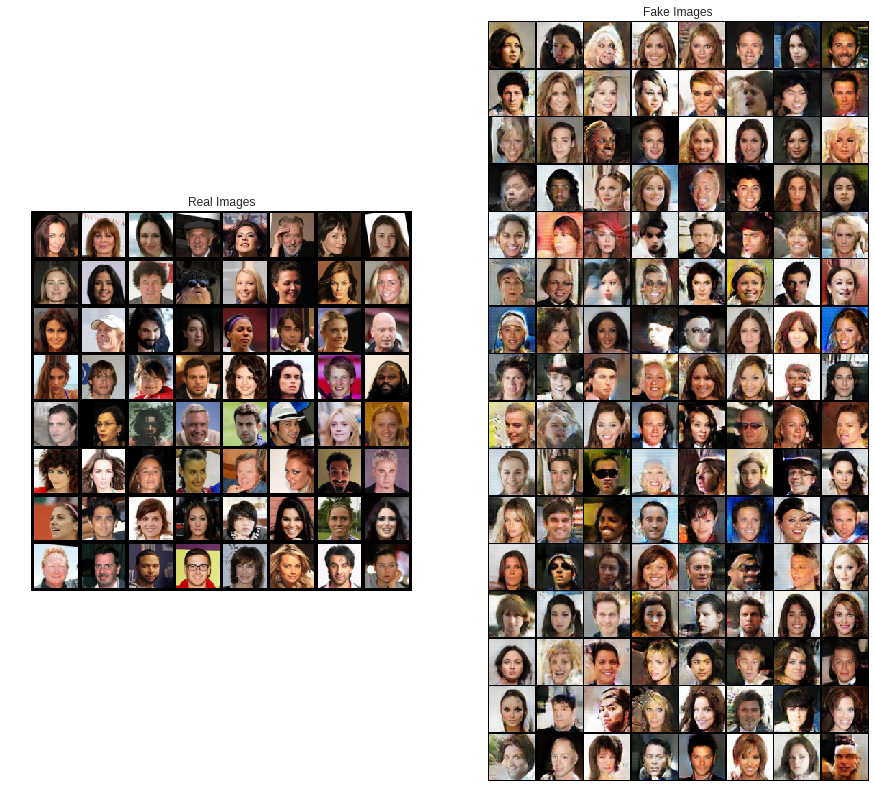

In [0]:
show_real_fake_images(dataloader, img_list_stable[-1])

## Progression through training

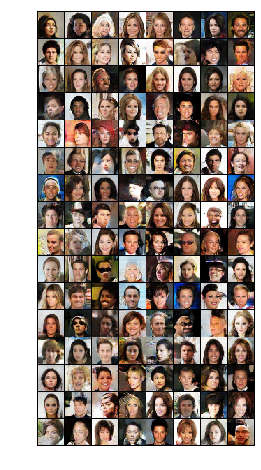

In [0]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_stable]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Viewing Latent Space

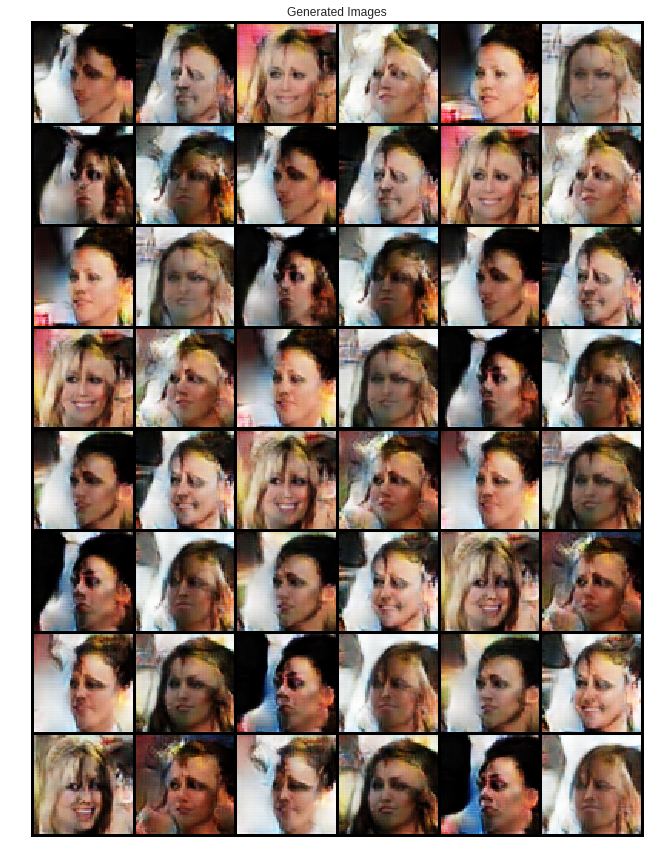

In [0]:
noise_1 = torch.rand((8,100,1,1))
noise_2 = torch.rand((8,100,1,1))
latent_embeding_show(projectedG, noise_1, noise_2, 6)

## Trying More filters

In [0]:
filters = generate_random_filters(24)
projectedD24 = DiscriminatorK(filters['p0'].shape[-1],filters['s0']).to(device)
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
projectedD24.apply(weights_init)

projectedG24 = Generator().to(device)
projectedG24.apply(weights_init)

img_list_stable, _, _ = train_gan(n_epochs,projectedD24,projectedG24,dataloader,fixed_noise,loss ='kl', filters=filters)
visualize_disc_generator_loss(G_losses_stable, D_losses_stable)

In [0]:
show_real_fake_images(dataloader, img_list_stable[-1])

# Loss difference between multiple disc and single disc

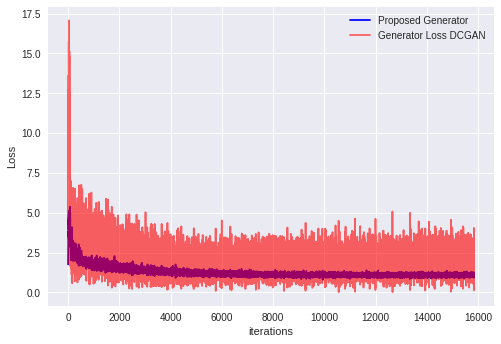

In [0]:
  n_iters = range(len(G_losses_stable))
  plt.plot(n_iters, G_losses_stable , 'b-')
  plt.plot(n_iters, G_losses, 'r-',alpha=0.6)
  plt.legend(['Proposed Generator','Generator Loss DCGAN'])
  plt.xlabel('iterations')
  plt.ylabel('Loss')
  plt.axis('tight')
  plt.show()